In [4]:
devtools::unload("rlang")

In [6]:
# Restart the Kernel

In [1]:
install.packages("bigrquery")

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



In [6]:
install.packages('DT')

also installing the dependencies ‘lazyeval’, ‘crosstalk’


Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



In [2]:
library(tidyverse)
library(DBI)

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.3.6      ✔ purrr   0.3.5 
✔ tibble  3.1.8      ✔ dplyr   1.0.10
✔ tidyr   1.2.1      ✔ stringr 1.4.1 
✔ readr   2.1.3      ✔ forcats 0.5.2 
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


In [7]:
library(stringr)
library(DT)

In [3]:
con <- dbConnect(
  bigrquery::bigquery(),
  project = "cal-itp-data-infra" ,
  dataset = "mart_gtfs" #,
#  billing = "billing"
  )

In [8]:
query2 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
dt, 
_extract_ts,
vpm.gtfs_dataset_key,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header,
datetime(_extract_ts, 'America/Los_Angeles') as _extract_ts_pacific, 
date(datetime(_extract_ts, 'America/Los_Angeles')) as dt_pacific,
time(datetime(_extract_ts, 'America/Los_Angeles')) as hour_pacific
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null

and (dt between '2024-06-08' and '2024-06-15')
and date(datetime(_extract_ts, 'America/Los_Angeles')) between '2024-06-09' and '2024-06-15'
),
cte3 as(
select distinct
dt_pacific, 
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header
from cte2
)
select *,
 PERCENTILE_CONT(_vehicle_message_age, .5) OVER(PARTITION BY dt_pacific) AS median_vehicle_message_age
 from cte3"
df2 = dbGetQuery(con, query2)

In [9]:
df21 = df2 %>%
    select(Date = dt_pacific, `Median Vehicle Message Age` = median_vehicle_message_age) %>%
    distinct() %>%
    arrange(Date)
df21

Date,Median Vehicle Message Age
<date>,<dbl>
2024-06-09,15333.0
2024-06-10,38677.0
2024-06-11,117050.0
2024-06-12,193524.0
2024-06-13,39412.0
2024-06-14,2504.0
2024-06-15,1790.5


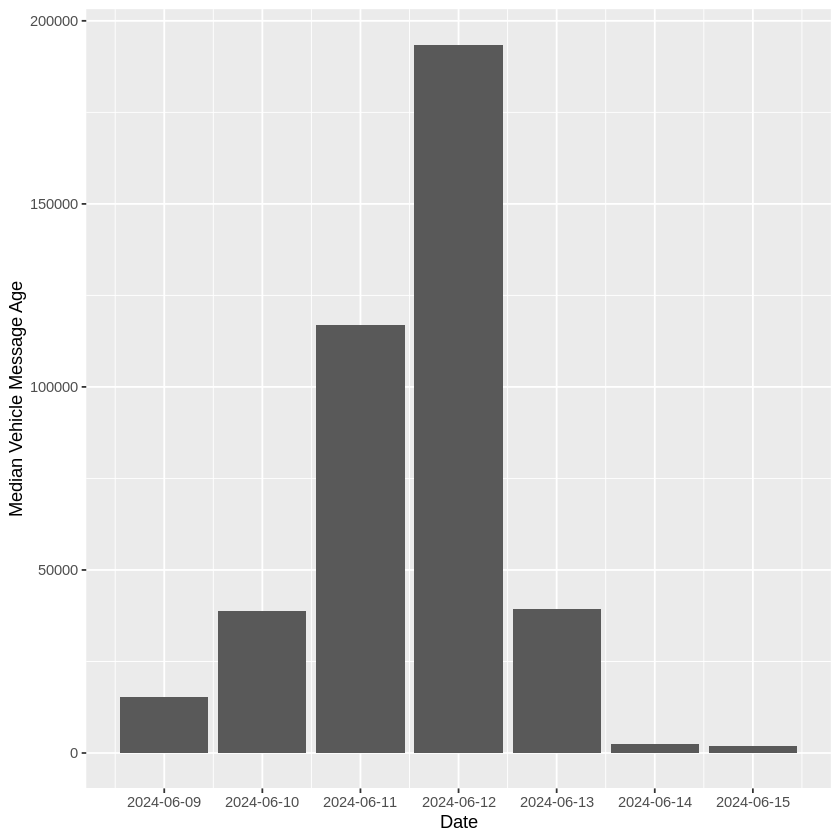

In [10]:
df21 %>% 
    ggplot(aes(Date, `Median Vehicle Message Age`)) +
    geom_bar(stat = 'identity') +
    scale_x_date(breaks = df21$Date)
           
           

In [11]:
summary(df21)

      Date            Median Vehicle Message Age
 Min.   :2024-06-09   Min.   :  1790            
 1st Qu.:2024-06-10   1st Qu.:  8918            
 Median :2024-06-12   Median : 38677            
 Mean   :2024-06-12   Mean   : 58327            
 3rd Qu.:2024-06-13   3rd Qu.: 78231            
 Max.   :2024-06-15   Max.   :193524            

In [12]:
glimpse(df21)

Rows: 7
Columns: 2
$ Date                         <date> 2024-06-09, 2024-06-10, 2024-06-11, 2024…
$ `Median Vehicle Message Age` <dbl> 15333.0, 38677.0, 117050.0, 193524.0, 394…


In [13]:
query211 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
dt, 
_extract_ts,
vpm.gtfs_dataset_key,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header,
datetime(_extract_ts, 'America/Los_Angeles') as _extract_ts_pacific, 
date(datetime(_extract_ts, 'America/Los_Angeles')) as dt_pacific,
time(datetime(_extract_ts, 'America/Los_Angeles')) as hour_pacific
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null

and (dt between '2024-06-08' and '2024-06-15')
and date(datetime(_extract_ts, 'America/Los_Angeles')) between '2024-06-09' and '2024-06-15'
),
cte3 as(
select distinct
dt_pacific, 
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header
from cte2
)
select *,
 from cte3"
df211 = dbGetQuery(con, query211)

In [14]:
summary(df211)

   dt_pacific         _header_message_age _vehicle_message_age
 Min.   :2024-06-09   Min.   :   -32      Min.   :   -48      
 1st Qu.:2024-06-10   1st Qu.:    -2      1st Qu.:  1515      
 Median :2024-06-12   Median :     9      Median : 27895      
 Mean   :2024-06-11   Mean   : 63891      Mean   :104999      
 3rd Qu.:2024-06-13   3rd Qu.:112141      3rd Qu.:179648      
 Max.   :2024-06-15   Max.   :344861      Max.   :689920      
                                          NA's   :132         
 _vehicle_message_age_vs_header
 Min.   :   -51                
 1st Qu.:    80                
 Median :   277                
 Mean   : 41095                
 3rd Qu.: 10846                
 Max.   :689921                
 NA's   :132                   

In [15]:
df212 = df211 %>%
    na.omit() %>% 
    select(`Date PST`= dt_pacific, `_header_message_age`, `_vehicle_message_age`) %>%
    distinct() %>% 
    group_by(`Date PST`) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(dom = 't'),
              caption = 'Vehicle Position Message Statistics, Week of June 09.'
             )
df212

HTML widgets cannot be represented in plain text (need html)

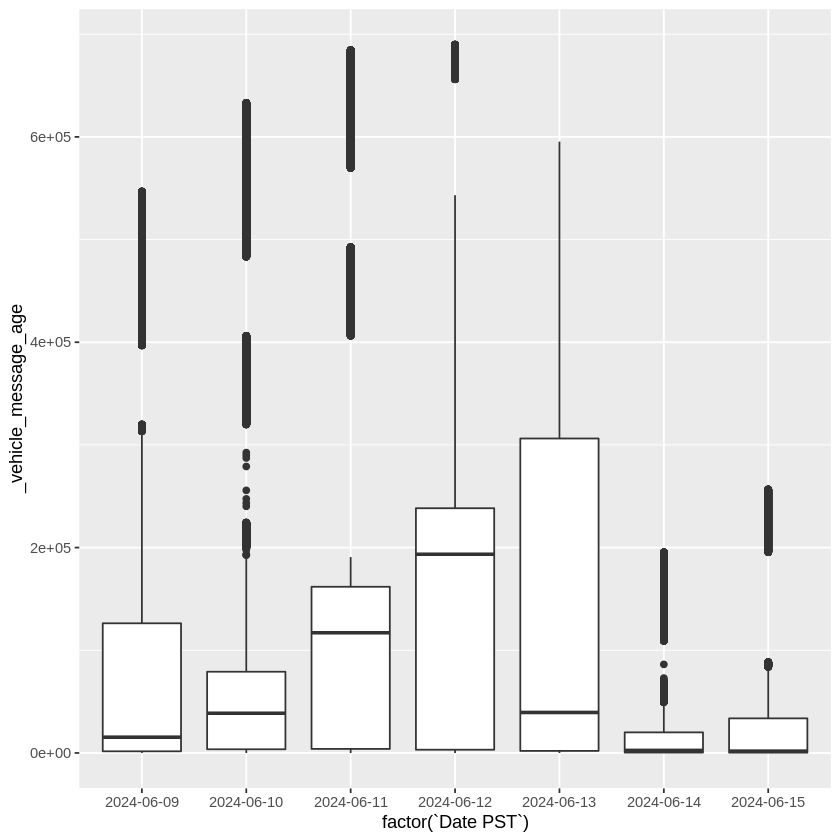

In [16]:
df211 %>%
    na.omit() %>% 
    select(`Date PST`= dt_pacific, `_header_message_age`, `_vehicle_message_age`) %>%
    distinct() %>% 
    ggplot(aes(factor(`Date PST`), `_vehicle_message_age`)) +
    geom_boxplot()

In [17]:
query3 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
#dt, 
#_extract_ts,
vpm.gtfs_dataset_key,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header,
datetime(_extract_ts, 'America/Los_Angeles') as _extract_ts_pacific, 
date(datetime(_extract_ts, 'America/Los_Angeles')) as dt_pacific,
time(datetime(_extract_ts, 'America/Los_Angeles')) as hour_pacific
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null

and (dt between '2024-06-08' and '2024-06-15')
and date(datetime(_extract_ts, 'America/Los_Angeles')) between '2024-06-09' and '2024-06-15'
),

cte21 as(
select *,
case
  when time(_extract_ts_pacific) between '07:30:00' and '08:30:00' then 'AM Peak'
  when time(_extract_ts_pacific) between '12:00:00' and '13:00:00' then 'Midday'
  when time(_extract_ts_pacific) between '16:00:00' and '17:00:00' then 'PM Peak'
  when time(_extract_ts_pacific) between '21:00:00' and '22:00:00' then 'Evening'
  else null
end as time_of_day
from cte2
),
cte3 as(
select distinct
dt_pacific, 
time_of_day,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header
from cte21
),
cte4 as(
select *,
  PERCENTILE_CONT(_vehicle_message_age, .5) OVER(PARTITION BY dt_pacific, time_of_day) AS median_vehicle_message_age
from cte3
)

select distinct dt_pacific, time_of_day, median_vehicle_message_age
from cte4
where time_of_day is not null
order by dt_pacific, time_of_day "

In [18]:
df3 = dbGetQuery(con, query3)

In [19]:
summary(df3)

   dt_pacific         time_of_day        median_vehicle_message_age
 Min.   :2024-06-09   Length:27          Min.   : 156.0            
 1st Qu.:2024-06-10   Class :character   1st Qu.: 250.0            
 Median :2024-06-12   Mode  :character   Median : 376.0            
 Mean   :2024-06-11                      Mean   : 732.8            
 3rd Qu.:2024-06-13                      3rd Qu.: 513.2            
 Max.   :2024-06-15                      Max.   :7363.0            

In [20]:
glimpse(df3)

Rows: 27
Columns: 3
$ dt_pacific                 <date> 2024-06-09, 2024-06-09, 2024-06-09, 2024-0…
$ time_of_day                <chr> "AM Peak", "Evening", "Midday", "PM Peak", …
$ median_vehicle_message_age <dbl> 219.0, 7363.0, 248.0, 252.0, 358.0, 1649.0,…


In [21]:
factor_level = c("AM Peak", "Midday", "PM Peak", "Evening")
df3$time_of_day = factor(df3$time_of_day, levels = factor_level)
df3

dt_pacific,time_of_day,median_vehicle_message_age
<date>,<fct>,<dbl>
2024-06-09,AM Peak,219.0
2024-06-09,Evening,7363.0
2024-06-09,Midday,248.0
2024-06-09,PM Peak,252.0
2024-06-10,AM Peak,358.0
2024-06-10,Evening,1649.0
2024-06-10,Midday,652.0
2024-06-10,PM Peak,509.5
2024-06-11,AM Peak,415.0


In [22]:
df3 = df3 %>% 
    select(Date = dt_pacific, `Time of Day` = time_of_day, `Median Vehicle Message Age` = median_vehicle_message_age) %>%
    arrange(Date, `Time of Day`)

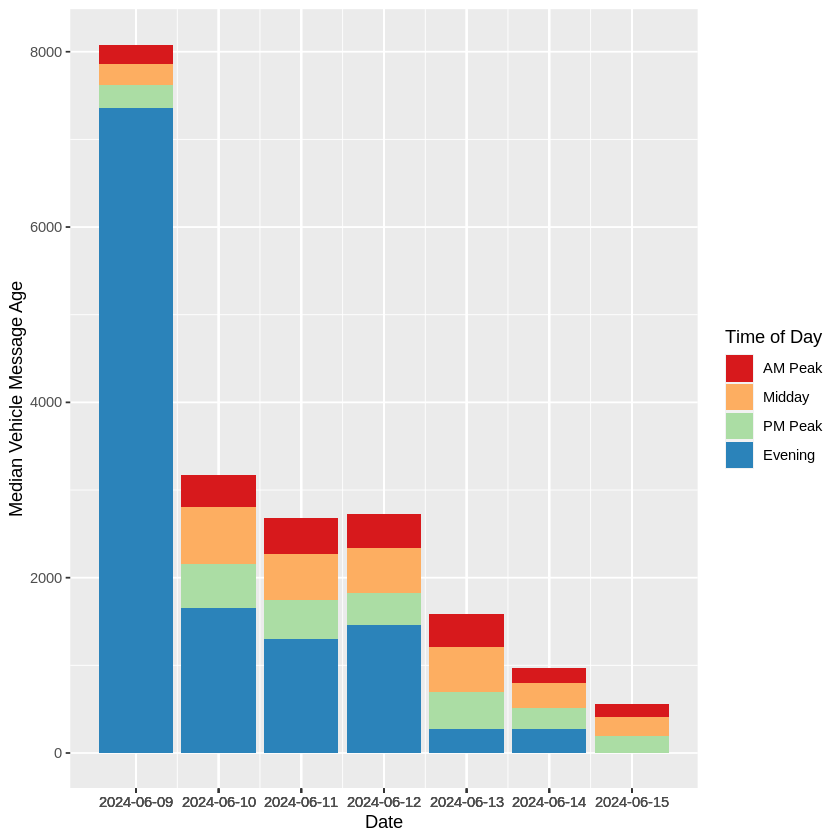

In [23]:
df3 %>% 
    ggplot(aes(Date, `Median Vehicle Message Age`)) +
    geom_bar(aes(fill = `Time of Day`), stat = 'identity') +
    scale_x_date(breaks = df3$Date) +
    labs(fill='Time of Day') +
    scale_fill_brewer(palette="Spectral")


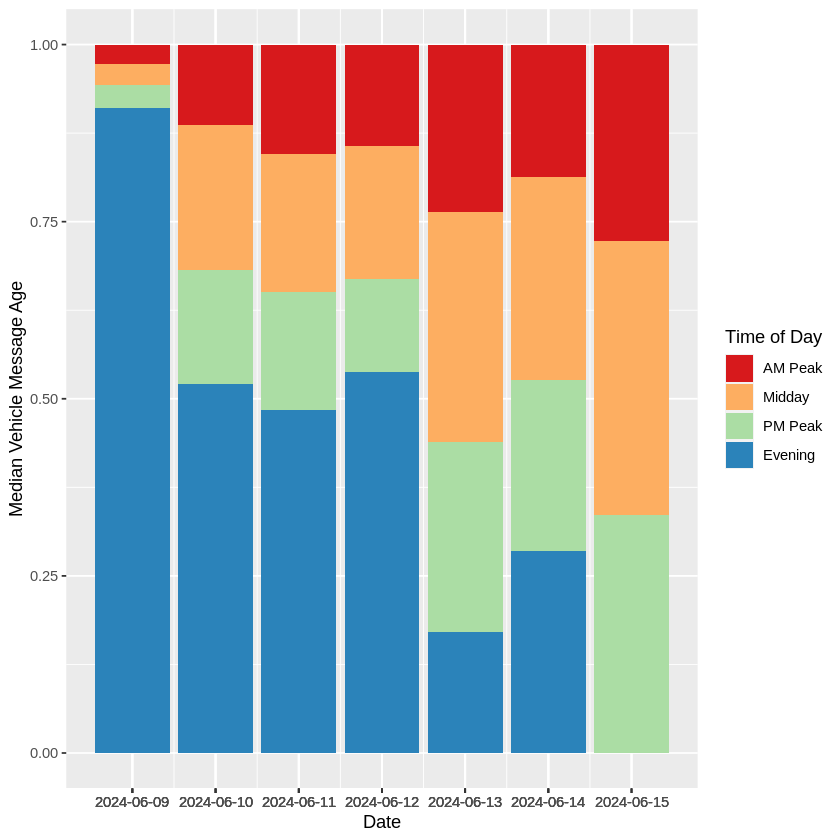

In [24]:
df3 %>% 
    ggplot(aes(Date, `Median Vehicle Message Age`)) +
    geom_bar(aes(fill = `Time of Day`), stat = 'identity', position = "fill") +
    scale_x_date(breaks = df3$Date) +
    labs(fill='Time of Day') +
    scale_fill_brewer(palette="Spectral")


In [25]:
query31 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
#dt, 
#_extract_ts,
vpm.gtfs_dataset_key,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header,
datetime(_extract_ts, 'America/Los_Angeles') as _extract_ts_pacific, 
date(datetime(_extract_ts, 'America/Los_Angeles')) as dt_pacific,
time(datetime(_extract_ts, 'America/Los_Angeles')) as hour_pacific
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null

and (dt between '2024-06-08' and '2024-06-15')
and date(datetime(_extract_ts, 'America/Los_Angeles')) between '2024-06-09' and '2024-06-15'
),

cte21 as(
select *,
case
  when time(_extract_ts_pacific) between '07:30:00' and '08:30:00' then 'AM Peak'
  when time(_extract_ts_pacific) between '12:00:00' and '13:00:00' then 'Midday'
  when time(_extract_ts_pacific) between '16:00:00' and '17:00:00' then 'PM Peak'
  when time(_extract_ts_pacific) between '21:00:00' and '22:00:00' then 'Evening'
  else null
end as time_of_day
from cte2
),
cte3 as(
select distinct
dt_pacific, 
time_of_day,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header
from cte21
),
cte4 as(
select *,
  PERCENTILE_CONT(_vehicle_message_age, .5) OVER(PARTITION BY dt_pacific, time_of_day) AS median_vehicle_message_age
from cte3
)

select *
from cte3
where time_of_day is not null
order by dt_pacific, time_of_day "
df31 = dbGetQuery(con, query31)

In [26]:
head(df31)

dt_pacific,time_of_day,_header_message_age,_vehicle_message_age,_vehicle_message_age_vs_header
<date>,<chr>,<int>,<int>,<int>
2024-06-09,AM Peak,22,440,418
2024-06-09,AM Peak,-2,58672,58674
2024-06-09,AM Peak,23,25431,25408
2024-06-09,AM Peak,-1,322,323
2024-06-09,AM Peak,17,82,65
2024-06-09,AM Peak,5,57,52


In [27]:
df32 = df31 %>%
    na.omit() %>% 
    group_by(dt_pacific, time_of_day) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = 'Vehicle Position Message Statistics categorized by time of the day.'
             )
df32

`summarise()` has grouped output by 'dt_pacific'. You can override using the
`.groups` argument.


HTML widgets cannot be represented in plain text (need html)

In [28]:
query4 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
vpm.gtfs_dataset_name, 
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header,
#datetime(_extract_ts, 'America/Los_Angeles') as _extract_ts_pacific, 
#date(datetime(_extract_ts, 'America/Los_Angeles')) as dt_pacific,
#time(datetime(_extract_ts, 'America/Los_Angeles')) as hour_pacific
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null
and dt between '2024-06-11' and '2024-06-12'
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-06-12'
),

cte3 as(
select distinct
gtfs_dataset_name,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header
from cte2
),
cte4 as(
select *,
  PERCENTILE_CONT(_vehicle_message_age, .5) OVER(PARTITION BY gtfs_dataset_name) AS median_vehicle_message_age
from cte3
)

select distinct gtfs_dataset_name, median_vehicle_message_age
from cte4
where median_vehicle_message_age is not null
order by median_vehicle_message_age"
df4 = dbGetQuery(con, query4)


In [29]:
df4 = df4 %>% select(`GTFS Feed Name` = gtfs_dataset_name, `Median Vehicle Message Age` = median_vehicle_message_age)

In [30]:
df4 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = 'Median of Vehicle Position Message Age by Agency'
             )
  

HTML widgets cannot be represented in plain text (need html)

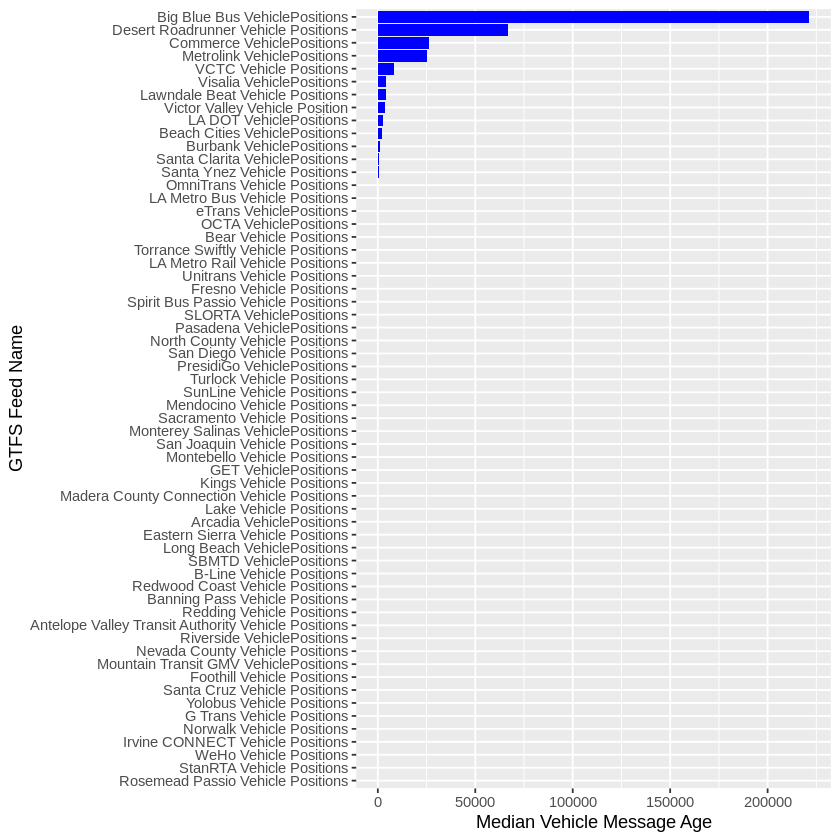

In [31]:
df4 %>% 
    filter(
        `Median Vehicle Message Age`> 20
        ) %>% 
    ggplot(aes(reorder(`GTFS Feed Name`, `Median Vehicle Message Age`), `Median Vehicle Message Age`)) +
    geom_bar(stat = 'identity', fill = "blue") +
    xlab("GTFS Feed Name") +
    # theme(axis.text.x = element_text(angle = 90)) +
    coord_flip()


In [32]:
df5 = df4
df5$`GTFS Feed Name`= df5$`GTFS Feed Name` %>% str_replace(" Vehicle Position", "")
df5$`GTFS Feed Name`= df5$`GTFS Feed Name` %>% str_replace(" VehiclePosition", "")

# df5

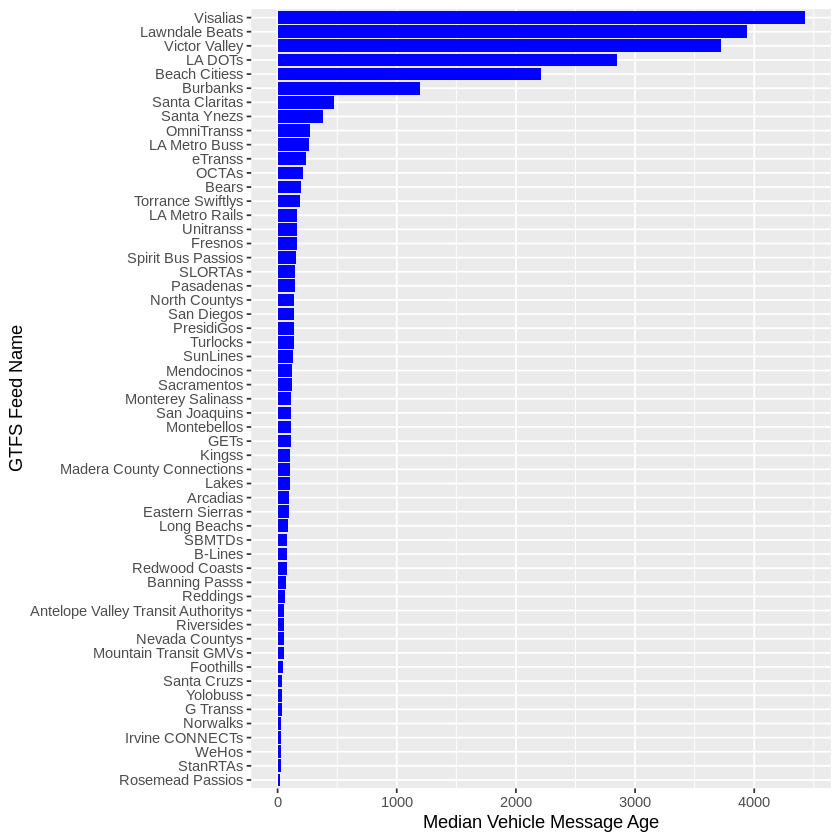

In [33]:
df5 %>% 
    filter(
        `Median Vehicle Message Age`> 20
        ,
        `Median Vehicle Message Age`< 5000
        ) %>% 
    ggplot(aes(reorder(`GTFS Feed Name`, `Median Vehicle Message Age`), `Median Vehicle Message Age`)) +
    geom_bar(stat = 'identity', fill = "blue") +
    xlab("GTFS Feed Name") +
    coord_flip()
    # theme(axis.text.x = element_text(angle = 90)) 
    # theme(axis.text.x = element_text(angle = 45, vjust=0.5)) 
    # scale_fill_brewer(palette="Spectral")

In [34]:
query41 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
vpm.gtfs_dataset_name, 
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header,
#datetime(_extract_ts, 'America/Los_Angeles') as _extract_ts_pacific, 
#date(datetime(_extract_ts, 'America/Los_Angeles')) as dt_pacific,
#time(datetime(_extract_ts, 'America/Los_Angeles')) as hour_pacific
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null
and dt between '2024-06-11' and '2024-06-12'
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-06-12'
),

cte3 as(
select distinct
gtfs_dataset_name,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header
from cte2
),
cte4 as(
select *,
  PERCENTILE_CONT(_vehicle_message_age, .5) OVER(PARTITION BY gtfs_dataset_name) AS median_vehicle_message_age
from cte3
)

select *
from cte3"
df41 = dbGetQuery(con, query41)


In [35]:
head(df41)

gtfs_dataset_name,_header_message_age,_vehicle_message_age,_vehicle_message_age_vs_header
<chr>,<int>,<int>,<int>
Nevada County Vehicle Positions,0,562,562
Banning Pass Vehicle Positions,3,252,249
PresidiGo VehiclePositions,-4,0,4
PresidiGo VehiclePositions,-2,1,3
Antelope Valley Transit Authority Vehicle Positions,-4,33,37
Antelope Valley Transit Authority Vehicle Positions,-3,49,52


In [36]:
df42 = df41 %>%
    na.omit() %>% 
    group_by(gtfs_dataset_name) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = 'Vehicle Position Message Statistics by Transit Agency'
             )
df42

HTML widgets cannot be represented in plain text (need html)

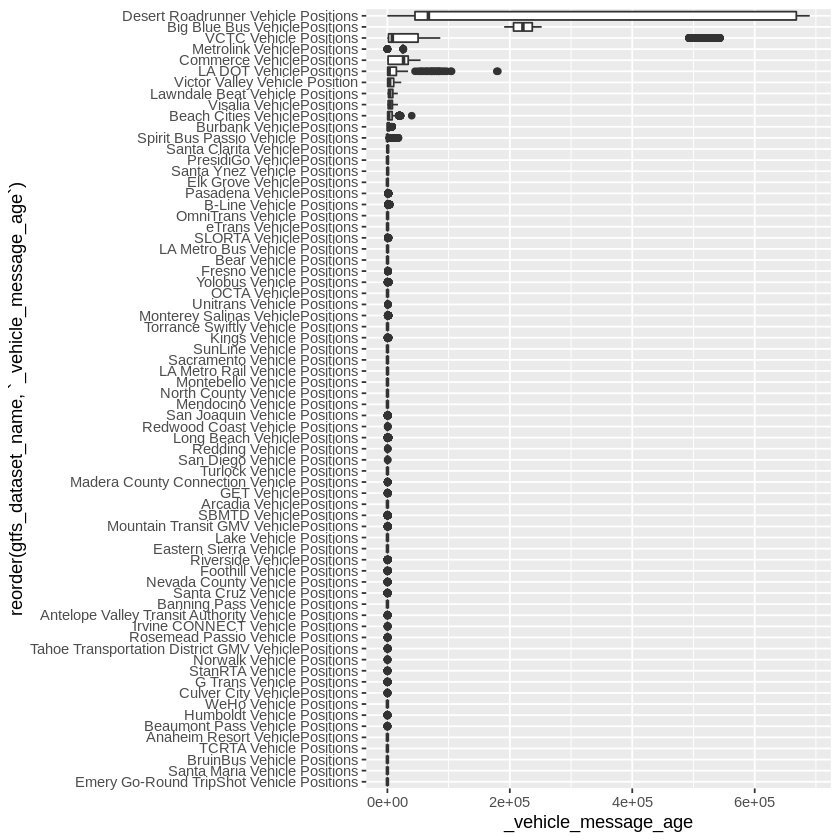

In [37]:
df41 %>%
    na.omit() %>% 
    # filter(gtfs_dataset_name != 'VCTC Vehicle Positions',
    #        gtfs_dataset_name != 'Desert Roadrunner Vehicle Positions',
    #        gtfs_dataset_name != 'VCTC Vehicle Positions',
    #        gtfs_dataset_name != 'Desert Roadrunner Vehicle Positions',
    #       ) %>% 
    # select(gtfs_dataset_name, `_header_message_age`, `_vehicle_message_age`) %>%
    # distinct() %>% 
    ggplot(aes(reorder(gtfs_dataset_name, `_vehicle_message_age`), `_vehicle_message_age`)) +
    geom_boxplot()+
    coord_flip()

In [38]:
query94 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
vpm.gtfs_dataset_name, 
_header_message_age, 
_vehicle_message_age
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null
and dt between '2024-06-11' and '2024-06-12'
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-06-12'
),

cte100 as(
SELECT gtfs_dataset_name, max(_valid_from) as max_valid_from
FROM `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` 
where #_is_current is true
'2024-06-12' between date(datetime(_valid_from, 'America/Los_Angeles')) and date(datetime(_valid_to, 'America/Los_Angeles'))
and organization_name != 'Anaheim Transportation Network'
and organization_name != 'City of Santa Monica'
and organization_name != 'City of Commerce'
group by gtfs_dataset_name
),
cte101 as(
SELECT bo.gtfs_dataset_name, bo.organization_name
FROM `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` bo
inner join cte100 c100
on bo.gtfs_dataset_name = c100.gtfs_dataset_name
where #_is_current is true
'2024-06-12' between date(datetime(_valid_from, 'America/Los_Angeles')) and date(datetime(_valid_to, 'America/Los_Angeles'))
and organization_name != 'Anaheim Transportation Network'
and organization_name != 'City of Santa Monica'
and organization_name != 'City of Commerce'
and _valid_from = c100.max_valid_from
),

cte21 as(
  select
  organization_name,
  c2.gtfs_dataset_name,
  _header_message_age, 
  _vehicle_message_age
  from cte2 c2
  inner join cte101 c101
  on c2.gtfs_dataset_name = c101.gtfs_dataset_name
)

select distinct organization_name, gtfs_dataset_name from cte21"
df94 = dbGetQuery(con, query94)


In [39]:
df5 = df94
df5$gtfs_dataset_name= df5$gtfs_dataset_name %>% str_replace(" Vehicle Position", "")
df5$gtfs_dataset_name= df5$gtfs_dataset_name %>% str_replace(" VehiclePosition", "")
df5 %>% 
    select(Agency = gtfs_dataset_name, Vendor = organization_name) %>% 
    arrange(Agency) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = 'Transit Agency to Vendor Association'
             )

HTML widgets cannot be represented in plain text (need html)

In [188]:
df5 %>% filter(organization_name == "TripShot Inc.")

organization_name,gtfs_dataset_name
<chr>,<chr>
TripShot Inc.,Anaheim Resorts
TripShot Inc.,BruinBuss
TripShot Inc.,Emery Go-Round TripShots
TripShot Inc.,Santa Marias
TripShot Inc.,TCRTAs


In [40]:
query95 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
vpm.gtfs_dataset_name, 
_header_message_age, 
_vehicle_message_age
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null
and dt between '2024-06-11' and '2024-06-12'
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-06-12'
),

cte100 as(
SELECT gtfs_dataset_name, max(_valid_from) as max_valid_from
FROM `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` 
where #_is_current is true
'2024-06-12' between date(datetime(_valid_from, 'America/Los_Angeles')) and date(datetime(_valid_to, 'America/Los_Angeles'))
and organization_name != 'Anaheim Transportation Network'
and organization_name != 'City of Santa Monica'
and organization_name != 'City of Commerce'
group by gtfs_dataset_name
),
cte101 as(
SELECT bo.gtfs_dataset_name, bo.organization_name
FROM `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` bo
inner join cte100 c100
on bo.gtfs_dataset_name = c100.gtfs_dataset_name
where #_is_current is true
'2024-06-12' between date(datetime(_valid_from, 'America/Los_Angeles')) and date(datetime(_valid_to, 'America/Los_Angeles'))
and organization_name != 'Anaheim Transportation Network'
and organization_name != 'City of Santa Monica'
and organization_name != 'City of Commerce'
and _valid_from = c100.max_valid_from
),

cte21 as(
  select
  organization_name,
  c2.gtfs_dataset_name,
  _header_message_age, 
  _vehicle_message_age
  from cte2 c2
  inner join cte101 c101
  on c2.gtfs_dataset_name = c101.gtfs_dataset_name
),

cte3 as(
select distinct
organization_name,
_header_message_age, 
_vehicle_message_age
from cte21
),
cte4 as(
select *,
  PERCENTILE_CONT(_vehicle_message_age, .5) OVER(PARTITION BY organization_name) AS median_vehicle_message_age
from cte3
),
cte5 as(
select distinct organization_name, median_vehicle_message_age
from cte4
where median_vehicle_message_age is not null
order by median_vehicle_message_age 
)

select * from cte5"
df95 = dbGetQuery(con, query95)

In [41]:
df95

organization_name,median_vehicle_message_age
<chr>,<dbl>
TripShot Inc.,2.5
City of Culver City,14.0
Stanislaus Regional Transit Authority,26.0
City of Gardena,33.0
Yolo County Transportation District,33.0
Clever Devices Ltd.,41.0
Passio Technologies,50.0
Mountain Area Regional Transit Authority,50.0
Riverside Transit Agency,53.0


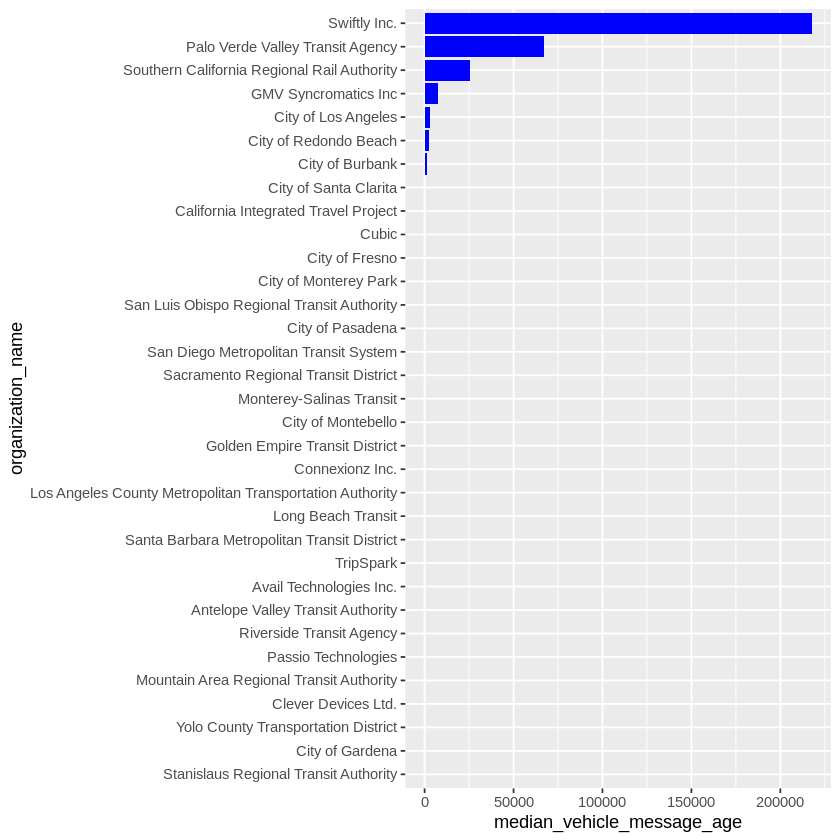

In [42]:
df95[df95$median_vehicle_message_age> 20, ] %>% 
    ggplot(aes(reorder(organization_name, median_vehicle_message_age), median_vehicle_message_age)) +
    geom_bar(stat = 'identity', fill = "blue") +
    xlab("organization_name") +
    coord_flip()
    # theme(axis.text.x = element_text(angle = 90)) 
    # theme(axis.text.x = element_text(angle = 45, vjust=0.5)) 

In [43]:
query96 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
vpm.gtfs_dataset_name, 
_header_message_age, 
_vehicle_message_age
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null
and dt between '2024-06-11' and '2024-06-12'
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-06-12'
),

cte100 as(
SELECT gtfs_dataset_name, max(_valid_from) as max_valid_from
FROM `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` 
where #_is_current is true
'2024-06-12' between date(datetime(_valid_from, 'America/Los_Angeles')) and date(datetime(_valid_to, 'America/Los_Angeles'))
and organization_name != 'Anaheim Transportation Network'
and organization_name != 'City of Santa Monica'
and organization_name != 'City of Commerce'
group by gtfs_dataset_name
),
cte101 as(
SELECT bo.gtfs_dataset_name, bo.organization_name
FROM `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` bo
inner join cte100 c100
on bo.gtfs_dataset_name = c100.gtfs_dataset_name
where #_is_current is true
'2024-06-12' between date(datetime(_valid_from, 'America/Los_Angeles')) and date(datetime(_valid_to, 'America/Los_Angeles'))
and organization_name != 'Anaheim Transportation Network'
and organization_name != 'City of Santa Monica'
and organization_name != 'City of Commerce'
and _valid_from = c100.max_valid_from
),

cte21 as(
  select
  organization_name,
  c2.gtfs_dataset_name,
  _header_message_age, 
  _vehicle_message_age
  from cte2 c2
  inner join cte101 c101
  on c2.gtfs_dataset_name = c101.gtfs_dataset_name
),

cte3 as(
select distinct
organization_name,
_header_message_age, 
_vehicle_message_age
from cte21
),
cte4 as(
select *,
  PERCENTILE_CONT(_vehicle_message_age, .5) OVER(PARTITION BY organization_name) AS median_vehicle_message_age
from cte3
)

select *
from cte3"
df96 = dbGetQuery(con, query96)

In [44]:
df97 = df96 %>%
    na.omit() %>% 
    group_by(organization_name) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = 'Vehicle Position Message Statistics by Vendor',
              colnames = c('Vendor' = 'organization_name')
             )
df97

HTML widgets cannot be represented in plain text (need html)

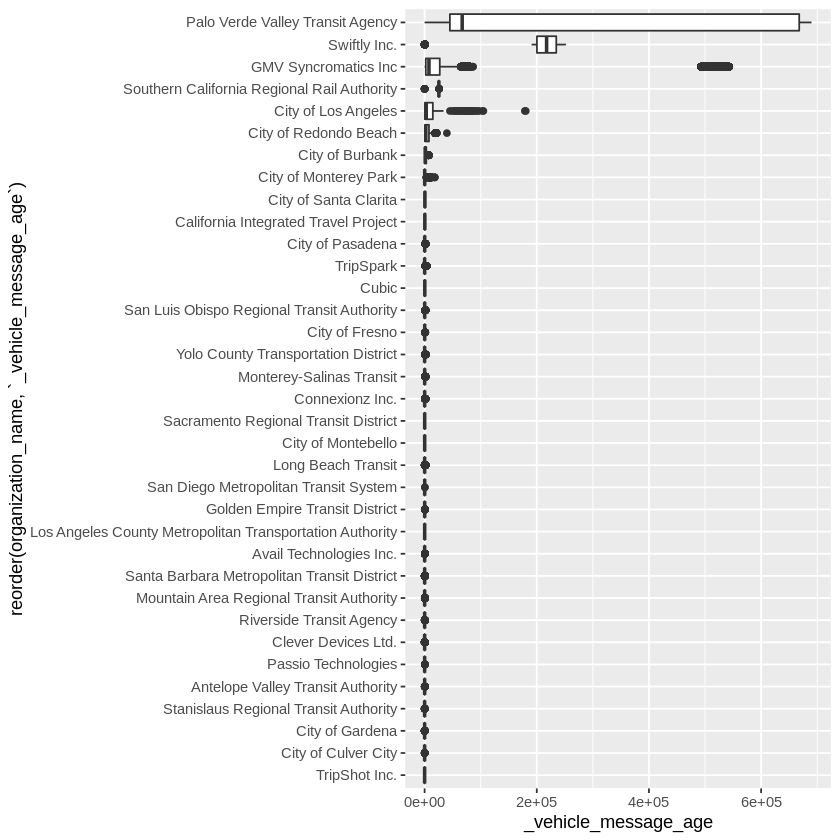

In [45]:
df96 %>%
    na.omit() %>% 
    # filter(gtfs_dataset_name != 'VCTC Vehicle Positions',
    #        gtfs_dataset_name != 'Desert Roadrunner Vehicle Positions',
    #        gtfs_dataset_name != 'VCTC Vehicle Positions',
    #        gtfs_dataset_name != 'Desert Roadrunner Vehicle Positions',
    #       ) %>% 
    # select(gtfs_dataset_name, `_header_message_age`, `_vehicle_message_age`) %>%
    # distinct() %>% 
    ggplot(aes(reorder(organization_name, `_vehicle_message_age`), `_vehicle_message_age`)) +
    geom_boxplot()+
    coord_flip()

In [46]:
query10 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
schedule_feed_key, 
_header_message_age, 
_vehicle_message_age
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null
and dt between '2024-06-11' and '2024-06-12'
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-06-12'
),
cte21 as(
SELECT distinct sf.key, route_type
FROM `cal-itp-data-infra.mart_gtfs.dim_trips` t
inner join `cal-itp-data-infra.mart_gtfs.dim_routes` r
on t.feed_key = r.feed_key
and t.route_id = r.route_id
inner join `cal-itp-data-infra.mart_gtfs.dim_schedule_feeds` sf
on t.base64_url = sf.base64_url
#where _is_current is true
),
cte22 as(
  select
  route_type,
  _header_message_age, 
  _vehicle_message_age
  from cte2 c2
  inner join cte21 c21
  on c2.schedule_feed_key = c21.key
),
cte3 as(
select distinct
route_type,
_header_message_age, 
_vehicle_message_age
from cte22
),
cte4 as(
select *,
  PERCENTILE_CONT(_vehicle_message_age, .5) OVER(PARTITION BY route_type) AS median_vehicle_message_age
from cte3
),
cte5 as(
select distinct route_type, median_vehicle_message_age
from cte4
where median_vehicle_message_age is not null
order by median_vehicle_message_age 
)

select * from cte5"
df10 = dbGetQuery(con, query10)
df10 

route_type,median_vehicle_message_age
<chr>,<dbl>
11,94
4,139
1,165
0,166
2,362
3,76833


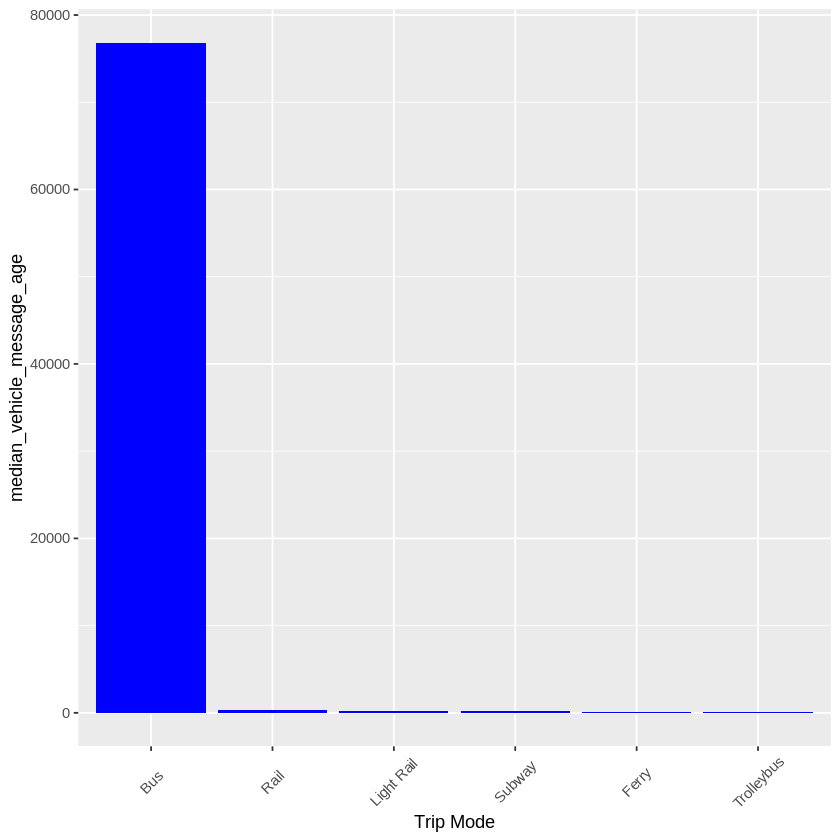

In [47]:
df10 %>% 
    mutate(`Trip Mode` = c("Trolleybus", "Ferry", "Subway", "Light Rail", "Rail", "Bus")) %>% 
    ggplot(aes(reorder(`Trip Mode`, -median_vehicle_message_age), median_vehicle_message_age)) +
    geom_bar(stat = 'identity', fill = "blue") +
    xlab("Trip Mode") +
    #theme(axis.text.x = element_text(angle = 90)) 
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) 

In [48]:
query101 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
schedule_feed_key, 
_header_message_age, 
_vehicle_message_age
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null
and dt between '2024-06-11' and '2024-06-12'
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-06-12'
),
cte21 as(
SELECT distinct sf.key, route_type
FROM `cal-itp-data-infra.mart_gtfs.dim_trips` t
inner join `cal-itp-data-infra.mart_gtfs.dim_routes` r
on t.feed_key = r.feed_key
and t.route_id = r.route_id
inner join `cal-itp-data-infra.mart_gtfs.dim_schedule_feeds` sf
on t.base64_url = sf.base64_url
#where _is_current is true
),
cte22 as(
  select
  route_type,
  _header_message_age, 
  _vehicle_message_age
  from cte2 c2
  inner join cte21 c21
  on c2.schedule_feed_key = c21.key
),
cte3 as(
select distinct
route_type,
_header_message_age, 
_vehicle_message_age
from cte22
)

select * from cte3"
df101 = dbGetQuery(con, query101)

In [49]:
head(df101)

route_type,_header_message_age,_vehicle_message_age
<chr>,<int>,<int>
3,190961,191044
3,192061,192134
3,1060,1064
3,217101,217190
3,217801,217869
3,218081,218161


In [50]:
df102 = df101 %>%
    na.omit() %>% 
    group_by(route_type) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) %>%
    arrange(Median) %>% 
    mutate(`Trip Mode` = c("Trolleybus", "Ferry", "Subway", "Light Rail", "Rail", "Bus")) %>% 
    select(`Trip Mode`, everything()) %>% 
    select(-route_type)
df102 %>%     
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = 'Vehicle Position Message Statistics by Vendor'#,
             )


HTML widgets cannot be represented in plain text (need html)

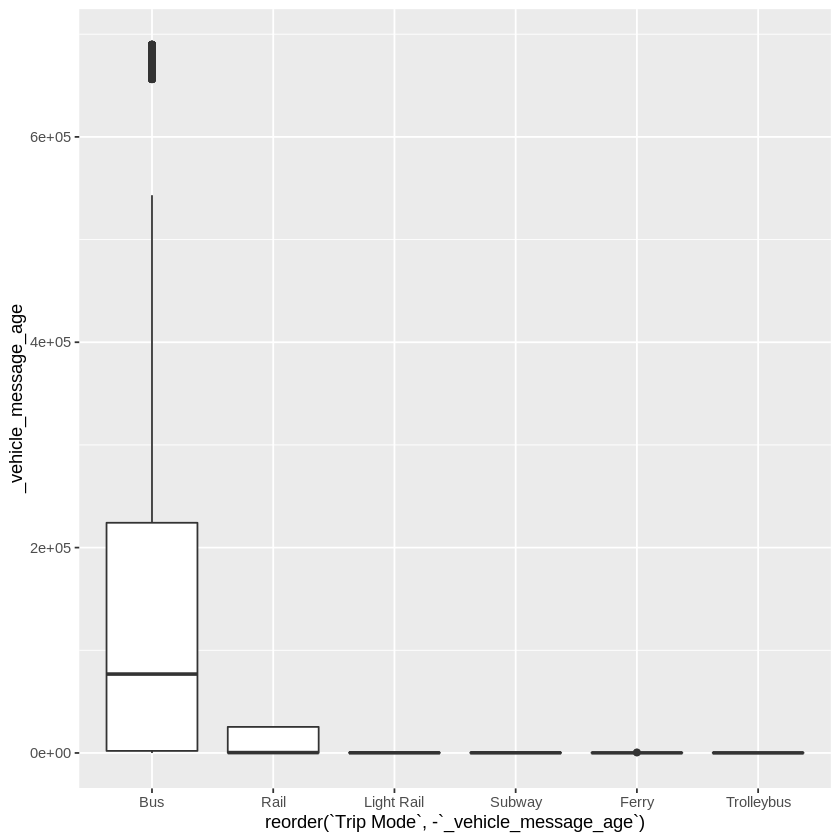

In [51]:
df101 %>%
    mutate(`Trip Mode` = recode(df101$route_type, "11" = "Trolleybus", "4" = "Ferry", "1" = "Subway", "0" = "Light Rail", "2" = "Rail", "3" = "Bus")) %>% 
    na.omit() %>%  
    ggplot(aes(reorder(`Trip Mode`, -`_vehicle_message_age`), `_vehicle_message_age`)) +
    geom_boxplot()

In [52]:
query11 = "with cte1 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte2 as(
SELECT 
vpm.gtfs_dataset_key,
trip_id,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header,
time(datetime(_extract_ts, 'America/Los_Angeles')) as time_pacific
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte1 c1
on vpm.gtfs_dataset_key = c1.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null
and (dt between '2024-06-11' and '2024-06-12')
and date(datetime(_extract_ts, 'America/Los_Angeles')) = '2024-06-12'
)
,

cte10 as(
SELECT distinct schedule_gtfs_dataset_key, vehicle_positions_gtfs_dataset_key,
FROM `cal-itp-data-infra.mart_transit_database.dim_provider_gtfs_data` 
where schedule_gtfs_dataset_key is not null
and vehicle_positions_gtfs_dataset_key is not null
and '2024-06-12' between date(datetime(_valid_from, 'America/Los_Angeles')) and date(datetime(_valid_to, 'America/Los_Angeles'))
),
cte11 as(
select 
vehicle_positions_gtfs_dataset_key,
trip_id, min(trip_first_departure_datetime_pacific) as trip_start, max(trip_last_arrival_datetime_pacific)as trip_end
from `cal-itp-data-infra.mart_gtfs.fct_scheduled_trips` st
inner join cte10
on st.gtfs_dataset_key = cte10.schedule_gtfs_dataset_key 
where trip_start_date_pacific = '2024-06-12'
and date(trip_last_arrival_datetime_pacific) = '2024-06-12'
group by vehicle_positions_gtfs_dataset_key, trip_id
),

cte4 as(
select vehicle_positions_gtfs_dataset_key, trip_id, time(trip_start) as trip_start_time, time(trip_end) as trip_end_time
from cte11
)
,
cte5 as(
select 
-- cte2.time_pacific, cte4.trip_start_time, cte4.trip_end_time,
case
  when time_pacific < trip_start_time then 'before scheduled trip start time'
  when time_pacific between trip_start_time and trip_end_time then 'during scheduled trip'
  else 'post scheduled trip end time'
end as time_of_message,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header,
  from cte2
  inner join cte4
  on cte2.gtfs_dataset_key = cte4.vehicle_positions_gtfs_dataset_key
  and 
cte2.trip_id = cte4.trip_id 
)

,
cte6 as(
select distinct
time_of_message,
_header_message_age, 
_vehicle_message_age,
_vehicle_message_age_vs_header
from cte5
),
cte7 as(
select *,
  PERCENTILE_CONT(_vehicle_message_age, .5) OVER(PARTITION BY time_of_message) AS median_vehicle_message_age
from cte6
)

-- select distinct time_of_message, median_vehicle_message_age
-- from cte7
-- order by time_of_message
select * from cte7"

df11 = dbGetQuery(con, query11)

In [53]:
df11 = na.omit(df11)
head(df11)

time_of_message,_header_message_age,_vehicle_message_age,_vehicle_message_age_vs_header,median_vehicle_message_age
<chr>,<int>,<int>,<int>,<dbl>
before scheduled trip start time,40,25440,25400,9134
before scheduled trip start time,17,53,36,9134
before scheduled trip start time,-13,8917,8930,9134
before scheduled trip start time,-14,34,48,9134
before scheduled trip start time,18,31,13,9134
before scheduled trip start time,-13,-4,9,9134


In [54]:
df11 %>% 
    distinct(time_of_message, median_vehicle_message_age) %>% 
    arrange(time_of_message)


time_of_message,median_vehicle_message_age
<chr>,<dbl>
before scheduled trip start time,9134
during scheduled trip,235
post scheduled trip end time,2402


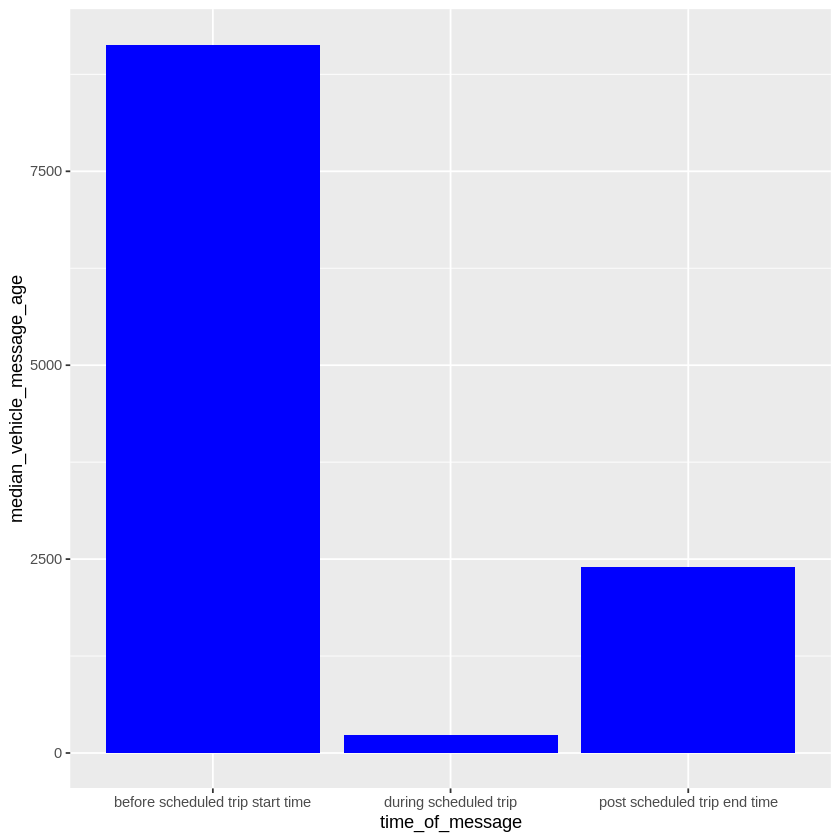

In [55]:
df11 %>% 
    distinct(time_of_message, median_vehicle_message_age) %>% 
    arrange(time_of_message) %>% 
    ggplot(aes(time_of_message, median_vehicle_message_age)) +
    geom_bar(stat = 'identity', fill = "blue") 
    # xlab("Trip Mode") +
    # # #theme(axis.text.x = element_text(angle = 90)) 
    # theme(axis.text.x = element_text(angle = 45, vjust=0.5)) 

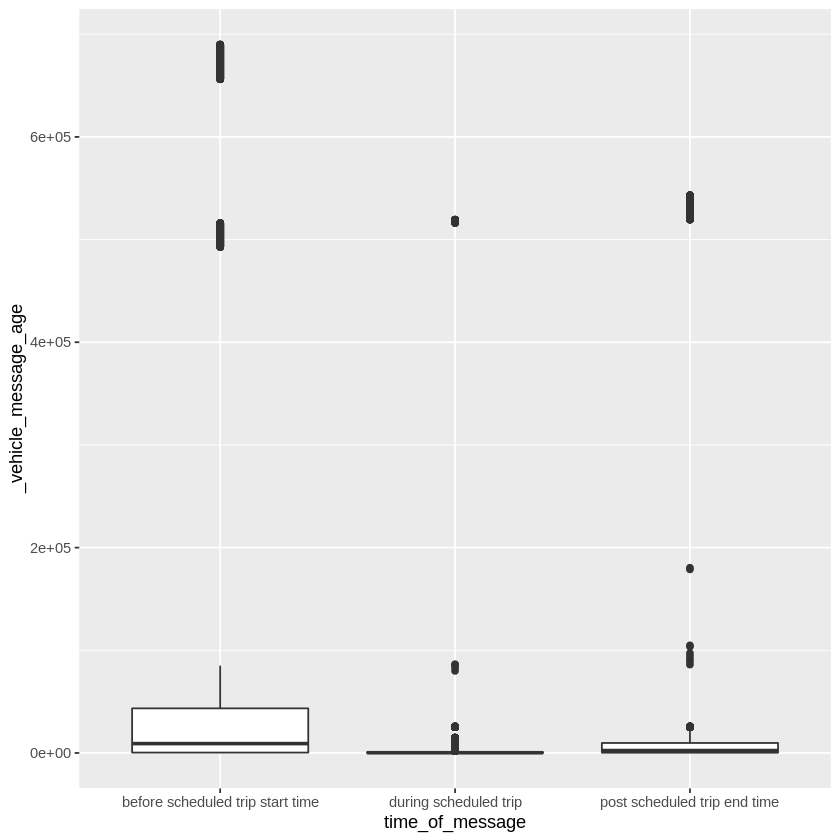

In [56]:
df11 %>% 
    ggplot(aes(time_of_message, `_vehicle_message_age`)) +
    geom_boxplot()

In [57]:
df11 %>% dim()

[1] 66140     5

In [58]:
table1 = df11 %>% 
    group_by(time_of_message) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             )


In [59]:
datatable(table1, 
          class = 'cell-border stripe', 
          options = list(dom = 't'),
          caption = 'Vehicle position message age by reference to trip start and end time.'
         )

HTML widgets cannot be represented in plain text (need html)

In [81]:
query12 = "with
cte1 as(
SELECT gtfs_dataset_name, max(_valid_from) as max_valid_from
FROM `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` 
group by gtfs_dataset_name
),
cte2 as(
SELECT bo.gtfs_dataset_name, organization_name, _valid_from, _valid_to
FROM `cal-itp-data-infra.mart_transit_database.bridge_organizations_x_gtfs_datasets_produced` bo
inner join cte1 c1
on bo.gtfs_dataset_name = c1.gtfs_dataset_name
where _valid_from = c1.max_valid_from
and organization_name in (
  'TripShot Inc.',
  'Clever Devices Ltd.',
  'Passio Technologies',
  'Avail Technologies Inc.',
  'TripSpark',
  'Connexionz Inc.',
  'Cubic',
  'California Integrated Travel Project',
  'GMV Syncromatics Inc',
  'Swiftly Inc.'
)
),
cte3 as(
  SELECT
  date_range
FROM
  UNNEST(GENERATE_DATE_ARRAY('2024-06-01', '2024-06-27')) AS date_range
), 
cte4 as(
select gtfs_dataset_name, organization_name, date_range
from  cte2 
inner join cte3
on date_range between date(_valid_from) and date(_valid_to)
order by gtfs_dataset_name, date_range
),

cte5 as(
  select distinct gtfs_dataset_key
  from `cal-itp-data-infra.mart_transit_database.dim_gtfs_service_data`
  where customer_facing is true
),
cte6 as(
SELECT 
dt, 
gtfs_dataset_name,
_header_message_age, 
_vehicle_message_age,
from `cal-itp-data-infra.mart_gtfs.fct_vehicle_positions_messages` vpm
inner join cte5 c5
on vpm.gtfs_dataset_key = c5.gtfs_dataset_key
where 
gtfs_dataset_name not like 'Bay Area 511%'
and trip_id is not null
and dt between '2024-06-01' and '2024-06-27'
),

cte7 as(
  select distinct
  dt,
  organization_name,
  _header_message_age, 
  _vehicle_message_age
  from cte4 c4
  inner join cte6 c6
  on c4.gtfs_dataset_name = c6.gtfs_dataset_name
  and dt = date_range
  order by organization_name, dt
)
select *,
 from cte7
"
df12 = dbGetQuery(con, query12)

Auto-refreshing stale OAuth token.



In [82]:
head(df12)

dt,organization_name,_header_message_age,_vehicle_message_age
<date>,<chr>,<int>,<int>
2024-06-01,Avail Technologies Inc.,-2,327
2024-06-01,Avail Technologies Inc.,-3,140
2024-06-01,Avail Technologies Inc.,-1,257
2024-06-01,Avail Technologies Inc.,0,24
2024-06-01,Avail Technologies Inc.,-1,575
2024-06-01,Avail Technologies Inc.,-2,201


In [157]:
vendors = sort(c('TripShot Inc.',
  'Clever Devices Ltd.',
  'Passio Technologies',
  'Avail Technologies Inc.',
  'TripSpark',
  'Connexionz Inc.',
  'Cubic',
  'California Integrated Travel Project',
  'GMV Syncromatics Inc',
  'Swiftly Inc.'
))
vendors

[1] "Avail Technologies Inc."             
 [2] "California Integrated Travel Project"
 [3] "Clever Devices Ltd."                 
 [4] "Connexionz Inc."                     
 [5] "Cubic"                               
 [6] "GMV Syncromatics Inc"                
 [7] "Passio Technologies"                 
 [8] "Swiftly Inc."                        
 [9] "TripShot Inc."                       
[10] "TripSpark"

In [153]:
vendors

[1] "TripShot Inc."                       
 [2] "Clever Devices Ltd."                 
 [3] "Passio Technologies"                 
 [4] "Avail Technologies Inc."             
 [5] "TripSpark"                           
 [6] "Connexionz Inc."                     
 [7] "Cubic"                               
 [8] "California Integrated Travel Project"
 [9] "GMV Syncromatics Inc"                
[10] "Swiftly Inc."

In [164]:
V = vendors[1]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

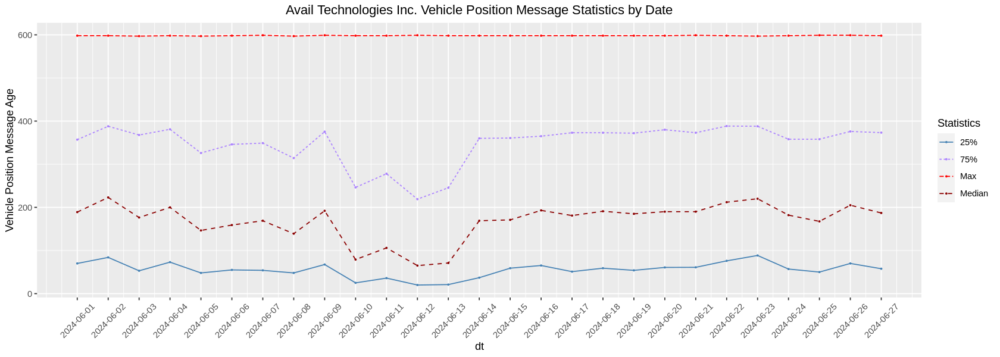

In [165]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))

In [166]:
V = vendors[2]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

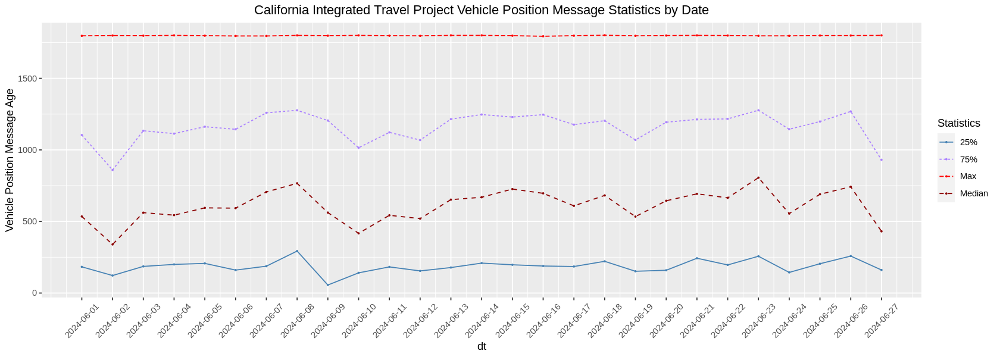

In [167]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))

In [168]:
V = vendors[3]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

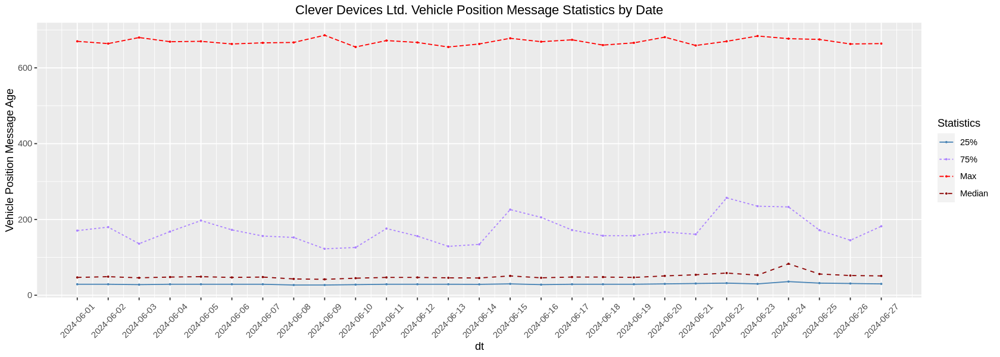

In [169]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))

In [170]:
V = vendors[4]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

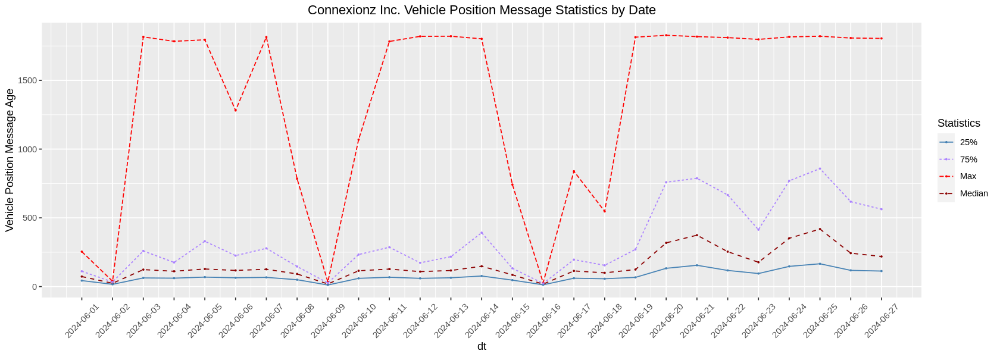

In [171]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))

In [174]:
V = vendors[5]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

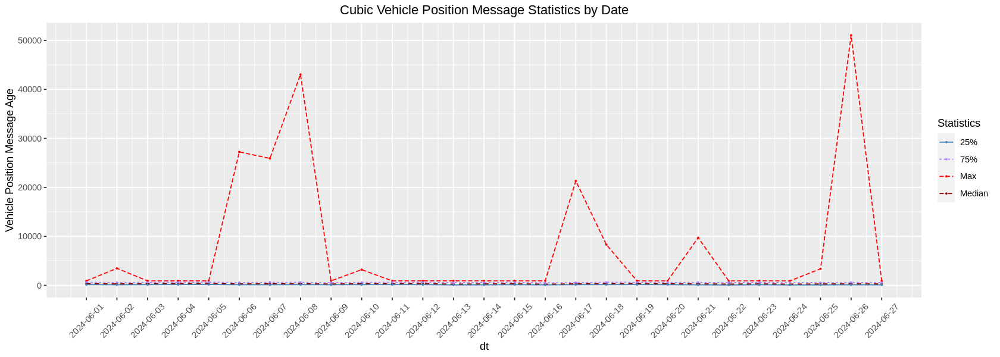

In [175]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))

In [176]:
V = vendors[6]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

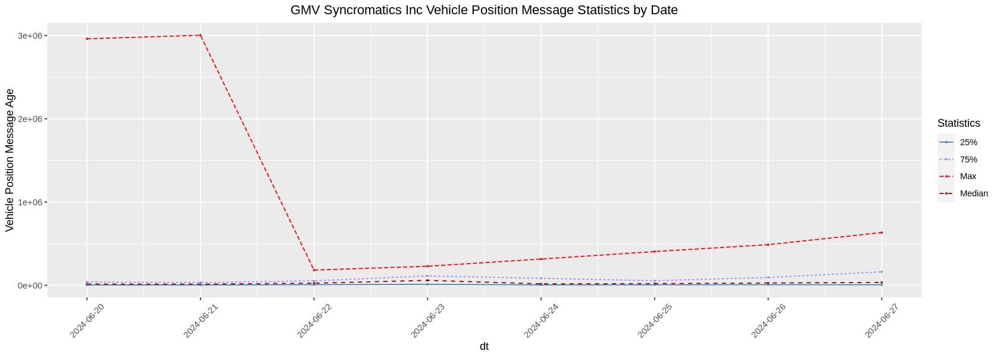

In [177]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))

In [178]:
V = vendors[7]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

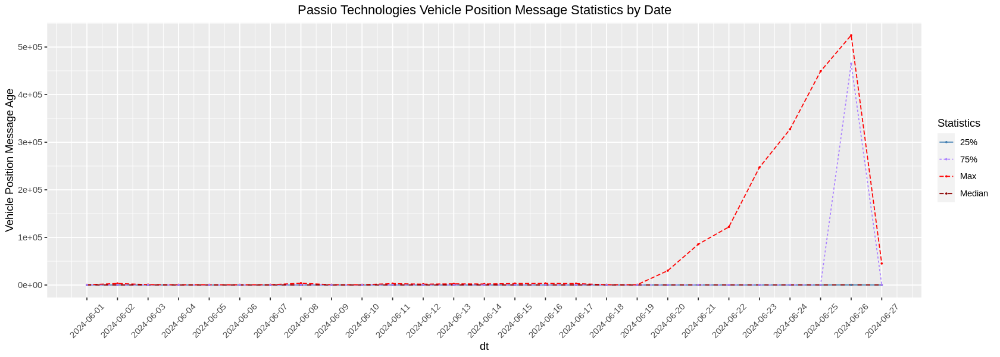

In [179]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))

In [180]:
V = vendors[8]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

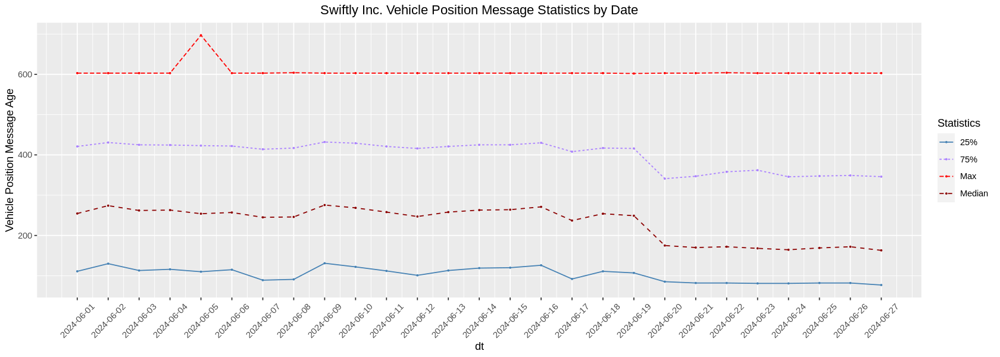

In [181]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))

In [182]:
V = vendors[9]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

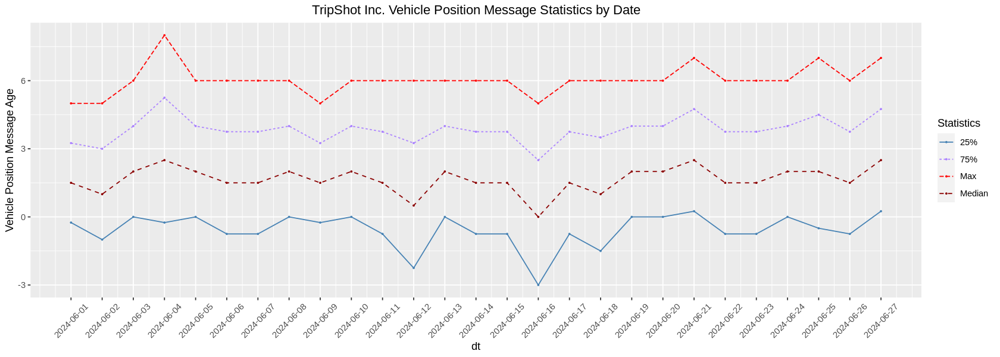

In [183]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))

In [184]:
V = vendors[10]
df121 = df12 %>% 
    filter(organization_name == V) %>% 
    na.omit() %>% 
    group_by(dt) %>% 
    summarize(Min = min(`_vehicle_message_age`), 
              Median = median(`_vehicle_message_age`), 
              Max = max(`_vehicle_message_age`),
              `25%` = quantile(`_vehicle_message_age`, .25),
              `75%` = quantile(`_vehicle_message_age`, .75)
             ) 
df121 %>% 
    datatable(class = 'cell-border stripe', 
              options = list(pageLength = 100, dom = 't'),
              caption = paste0(V, ' Vehicle Position Message Statistics by Date')#,
              # colnames = c('Vendor' = 'organization_name')
             )

HTML widgets cannot be represented in plain text (need html)

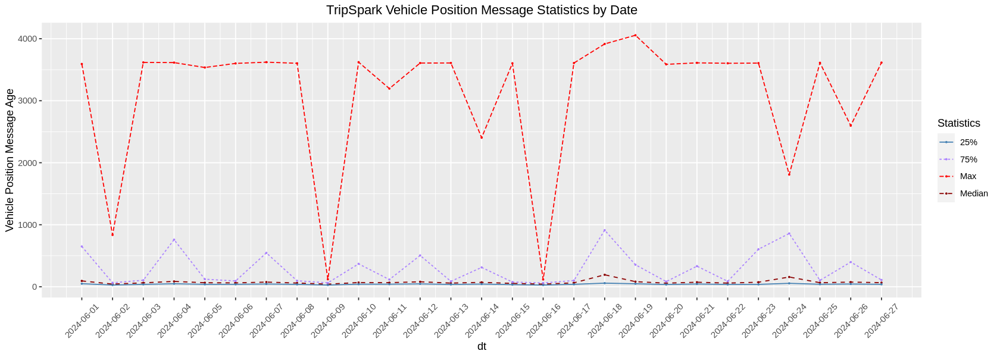

In [185]:
options(repr.plot.width = 14, repr.plot.height =5) 
df121 %>% 
    select(-Min) %>%
    # gather(key = "Statistics", value = "value", -dt) %>% 
    pivot_longer(names_to = "Statistics", values_to = "value", cols = -dt) %>% 
    ggplot(aes(x = dt, y = value)) +
    geom_line(aes(color = Statistics, linetype = Statistics)) + 
    geom_point(aes(color = Statistics), size = .4) + 
    scale_color_manual(values = c("steelblue", "MediumPurple1", "red", "darkred")) +
    scale_x_date(breaks = df121$dt) +
    ylab("Vehicle Position Message Age") +
    theme(axis.text.x = element_text(angle = 45, vjust=0.5)) +
    ggtitle(paste0(V, ' Vehicle Position Message Statistics by Date')) +
    theme(plot.title = element_text(hjust=0.5))